# Data

Nous disposons d'un ensemble de données de 17092 images de cellules normales du sang préphérique, les images sont réparties sur 8 classes de types distincts à savoir : 'basophil','eosinophil', 'erythroblast', 'immature granulocytes', 'lymphocyte', 'monocyte', 'neutrophil' et 'platelet'.

Dans ce notebook on va effectuer un audit général de nos images et quelques visualisations.  

# 1.1 Charger les données

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

import time

from tqdm import tqdm

import cv2

In [2]:
df_infos = pd.read_csv("df_infos.csv")
df_infos

,path_image,category,name,extension,width,height,dim,size
0,PBC_dataset_normal_DIB/basophil/BA_689200.jpg,basophil,BA_689200,jpg,363,360,3,363 x 360
1,PBC_dataset_normal_DIB/basophil/BA_883452.jpg,basophil,BA_883452,jpg,363,360,3,363 x 360
2,PBC_dataset_normal_DIB/basophil/BA_382161.jpg,basophil,BA_382161,jpg,369,366,3,369 x 366
3,PBC_dataset_normal_DIB/basophil/BA_175579.jpg,basophil,BA_175579,jpg,363,360,3,363 x 360
4,PBC_dataset_normal_DIB/basophil/BA_775722.jpg,basophil,BA_775722,jpg,363,360,3,363 x 360
...,...,...,...,...,...,...,...,...
17087,PBC_dataset_normal_DIB/platelet/PLATELET_49591...,platelet,PLATELET_495918,jpg,363,360,3,363 x 360
17088,PBC_dataset_normal_DIB/platelet/PLATELET_89723...,platelet,PLATELET_897238,jpg,363,360,3,363 x 360
17089,PBC_dataset_normal_DIB/platelet/PLATELET_75043...,platelet,PLATELET_750430,jpg,363,360,3,363 x 360
17090,PBC_dataset_normal_DIB/platelet/PLATELET_81043...,platelet,PLATELET_810431,jpg,363,360,3,363 x 360


# Informations génerales

In [3]:
print("Informations sur le jeu de données")
display(df_infos.info())

Informations sur le jeu de données
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 17092 entries, 0 to 17091
Data columns (total 8 columns):
 #   Column      Non-Null Count  Dtype 
---  ------      --------------  ----- 
 0   path_image  17092 non-null  object
 1   category    17092 non-null  object
 2   name        17092 non-null  object
 3   extension   17092 non-null  object
 4   width       17092 non-null  int64 
 5   height      17092 non-null  int64 
 6   dim         17092 non-null  int64 
 7   size        17092 non-null  object
dtypes: int64(3), object(5)
memory usage: 1.0+ MB


None

In [4]:
print("Combien de valeurs nulles dans df_infos?")
df_infos.isnull().sum()

Combien de valeurs nulles dans df_infos?


path_image    0
category      0
name          0
extension     0
width         0
height        0
dim           0
size          0
dtype: int64

In [5]:
print("Combien de doublons dans df_infos?")
df_infos.duplicated().sum()

Combien de doublons dans df_infos?


0

# Distributions (en %)

### En fonction de l'extension

In [6]:
print("Nombre d'images par extension")
df_infos['extension'].value_counts()

Nombre d'images par extension


jpg    17092
Name: extension, dtype: int64

### En fonction de la taille (size)

In [7]:
# On regarde le nombre d'images présentes dans chaque catégories

print("Combien d'images par dimension?")
df_infos['size'].value_counts()

Combien d'images par dimension?


363 x 360    16639
369 x 366      250
360 x 360      198
361 x 360        2
360 x 361        1
360 x 359        1
360 x 362        1
Name: size, dtype: int64

### En fonction de category

In [8]:
print("Proportion d'images par catégorie")
df_infos['category'].value_counts(normalize=True)*100

Proportion d'images par catégorie


neutrophil      19.476948
eosinophil      18.236602
ig              16.937749
platelet        13.737421
erythroblast     9.074421
monocyte         8.307980
basophil         7.126141
lymphocyte       7.102738
Name: category, dtype: float64

### Visualisation de la distribution globale par catégorie en fonction du set

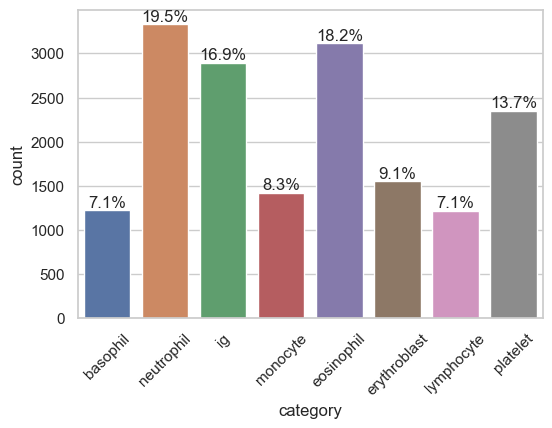

In [9]:
sns.set_theme(style="whitegrid")
plt.figure(figsize=(6,4))
ax = sns.countplot(x = df_infos['category']);
plt.xticks(rotation = 45)
for p in ax.patches:
    x=p.get_bbox().get_points()[:,0]
    y=p.get_bbox().get_points()[1,1]
    ax.annotate('{:.1f}%'.format(100.*y/len(df_infos)), (x.mean(), y), ha='center', va='bottom')

On remarque que les types de cellules sont pas toutes bien alimentées en images. Les cellules de type basophil, erythroblast, lymphocyte et monocyte le nombre d'images présent dans notre jeu de données pour ces types de cellules est inférieur à celui des cellules de type eosinophil, immature granulocytes et neutrophil.


**On crée un dataframe "img_random" en ne prenant qu'un echantillon de chaque catégorie pour faciliter la visualisation par la suite**

In [10]:
img_random = df_infos.groupby(df_infos['category']).apply(lambda x: x.sample(1)).reset_index(drop=True)
img_random

,path_image,category,name,extension,width,height,dim,size
0,PBC_dataset_normal_DIB/basophil/BA_406770.jpg,basophil,BA_406770,jpg,363,360,3,363 x 360
1,PBC_dataset_normal_DIB/eosinophil/EO_29868.jpg,eosinophil,EO_29868,jpg,363,360,3,363 x 360
2,PBC_dataset_normal_DIB/erythroblast/ERB_289947...,erythroblast,ERB_289947,jpg,360,360,3,360 x 360
3,PBC_dataset_normal_DIB/ig/PMY_196965.jpg,ig,PMY_196965,jpg,363,360,3,363 x 360
4,PBC_dataset_normal_DIB/lymphocyte/LY_893656.jpg,lymphocyte,LY_893656,jpg,363,360,3,363 x 360
5,PBC_dataset_normal_DIB/monocyte/MO_675551.jpg,monocyte,MO_675551,jpg,363,360,3,363 x 360
6,PBC_dataset_normal_DIB/neutrophil/SNE_619982.jpg,neutrophil,SNE_619982,jpg,363,360,3,363 x 360
7,PBC_dataset_normal_DIB/platelet/PLATELET_91996...,platelet,PLATELET_919965,jpg,363,360,3,363 x 360


### Visualisation d'un échantillon RGB pour chaque catégorie

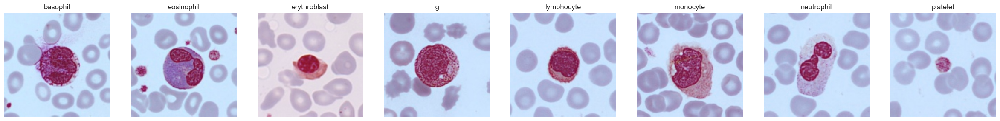

In [11]:
plt.figure(figsize=(30,5))

for i, path_image in enumerate(img_random['path_image']):
    plt.subplot(1,8,i+1)
    plt.title(img_random['category'][i])
    plt.axis('off')
    img = cv2.imread(path_image, cv2.IMREAD_COLOR)
    plt.imshow(img)

### Visualisation de l'histogramme des couleurs pour chaque échantillon RGB et GRAY de chaque categorie

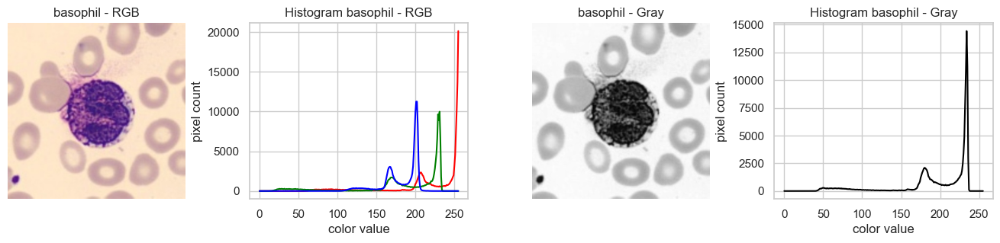

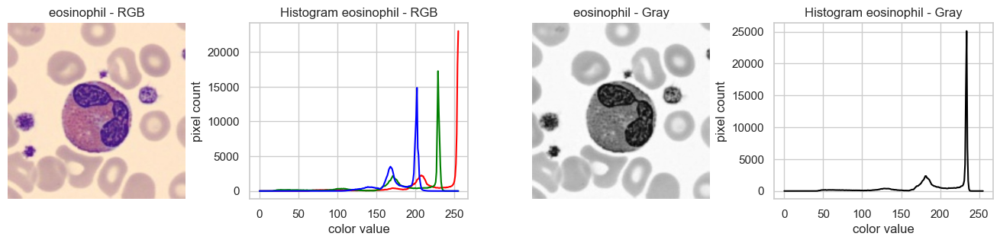

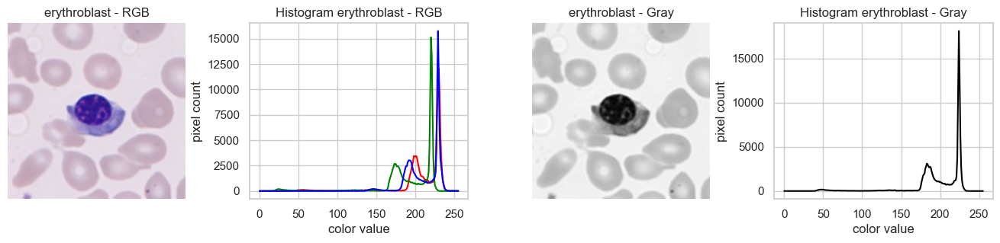

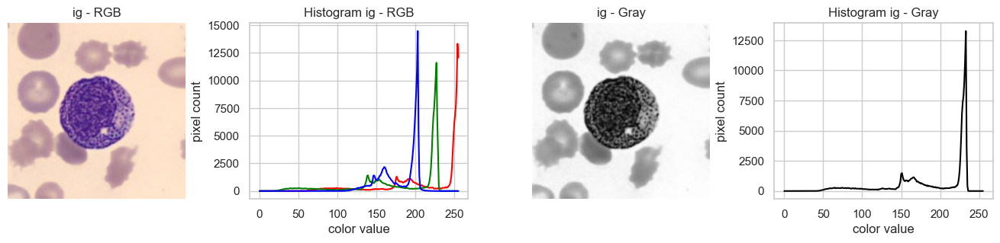

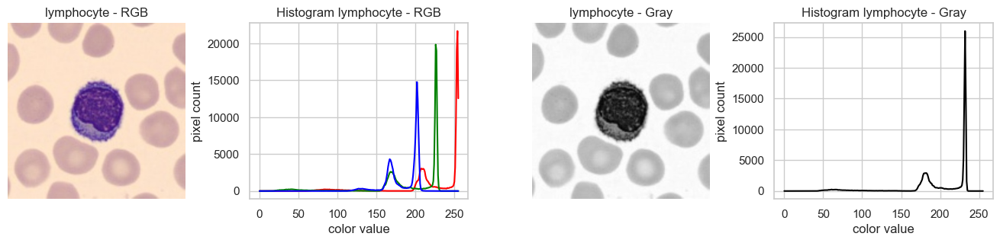

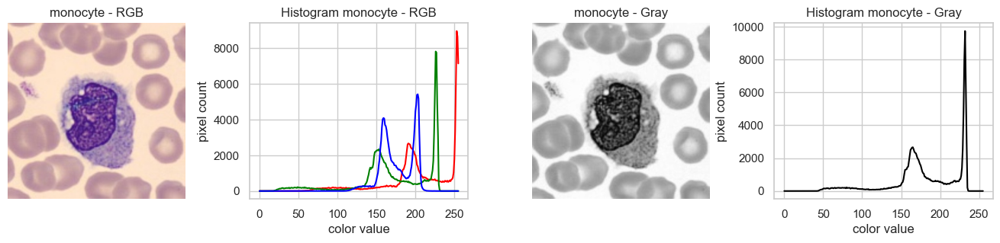

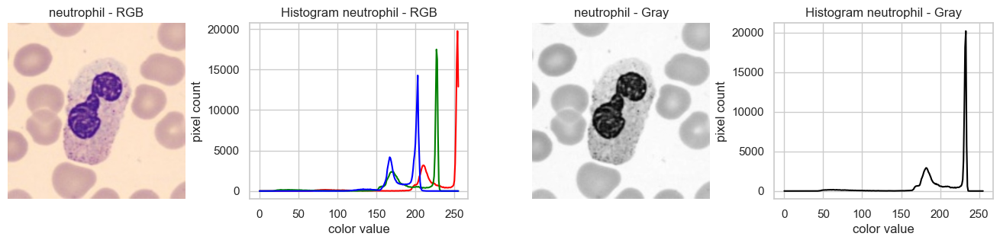

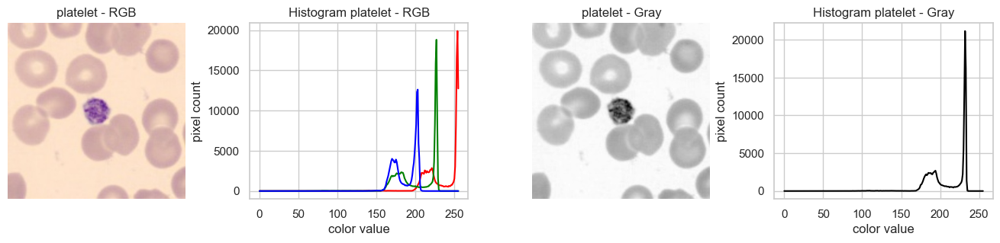

In [12]:
for i, path_image in enumerate(img_random['path_image']):
    plt.figure(figsize=(17,3))
    plt.subplot(1,4,1)
    img = cv2.imread(path_image, cv2.IMREAD_COLOR) 
    img_color = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.title(f"{img_random['category'][i]} - RGB")
    plt.axis('off')
    plt.imshow(img_color)
    
    plt.subplot(1,4,2)
    #plt.xlim([0, 256])
    #plt.ylim([0, 1000])
    for (j, color) in enumerate(("red", "green", "blue")):
        hist = cv2.calcHist([img_color],[j],None,[256],[0,256])
        plt.plot(hist,color = color)
        plt.title(f"Histogram {img_random['category'][i]} - RGB")
        plt.xlabel("color value")
        plt.ylabel("pixel count")
        
    plt.subplot(1,4,3)
    img = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)
    plt.axis('off')
    plt.title(f"{img_random['category'][i]} - Gray")
    plt.imshow(img, cmap='gray')
    
    plt.subplot(1,4,4)
    #plt.xlim([0, 256])
    #plt.ylim([0, 1000])
    hist_grey= cv2.calcHist([img],[0],None,[256],[0,256])
    plt.plot(hist_grey,color = 'black')
    plt.title(f"Histogram {img_random['category'][i]} - Gray")
    plt.xlabel("color value")
    plt.ylabel("pixel count")


### Visualisation des histogrammes moyens des couleurs pour tous les échantillons RGB de chaque categorie

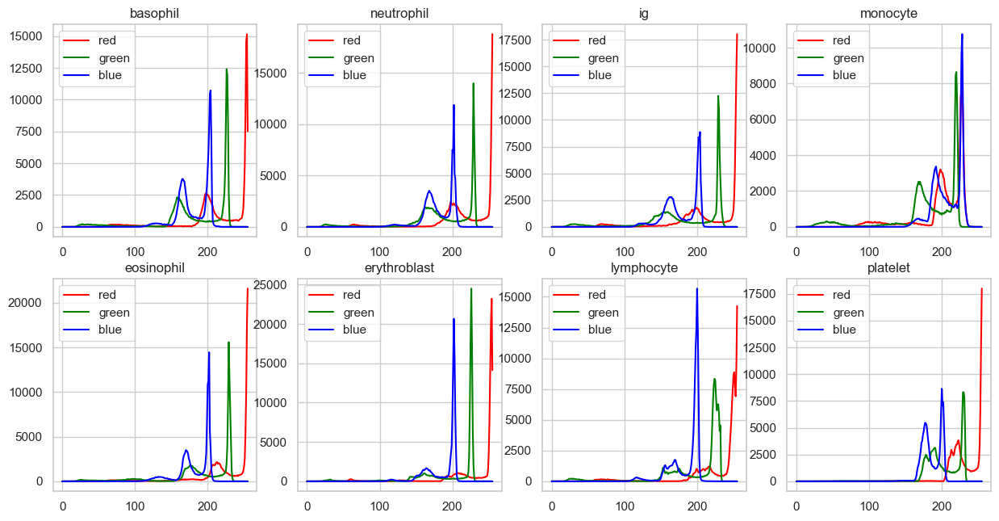

In [13]:
plt.figure(figsize=(15,7.5))
for id_cat, cat in enumerate(df_infos['category'].unique()):
    rgbcolors = ('red', 'green', 'blue')
    HISTR_COLOR = [[],[],[]]
    for color_id, color in enumerate(rgbcolors):
        for path_image in df_infos['path_image'][df_infos['category'] == cat]:                
            img_BGR = cv2.imread(path_image) 
            img_RGB = cv2.cvtColor(img_BGR, cv2.COLOR_BGR2RGB)
            histr_color = cv2.calcHist([img_RGB],[color_id],None,[256],[0,256])
        HISTR_COLOR[color_id].append(histr_color)                                    # creation d'une liste contenant tous les histogrammes/dossier
        HISTR_COLOR[color_id]= np.concatenate(HISTR_COLOR[color_id], axis=1)                #concatenation des arrays histo en colonnes (1 col/256 lignes)
        HISTR_COLOR[color_id]= np.mean(HISTR_COLOR[color_id], axis=1)                       #Moyennage de l'array conconténée
    plt.subplot(2,4,id_cat+1)
    plt.plot(HISTR_COLOR[0],color = rgbcolors[0], label = rgbcolors[0])
    plt.plot(HISTR_COLOR[1],color = rgbcolors[1], label = rgbcolors[1])  
    plt.plot(HISTR_COLOR[2],color = rgbcolors[2], label = rgbcolors[2])  
    plt.title(cat)
    plt.legend(loc = 'best')

### Visualisation des histogrammes moyens du niveau de gris (GRAY) pour tous les échantillons de chaque categorie

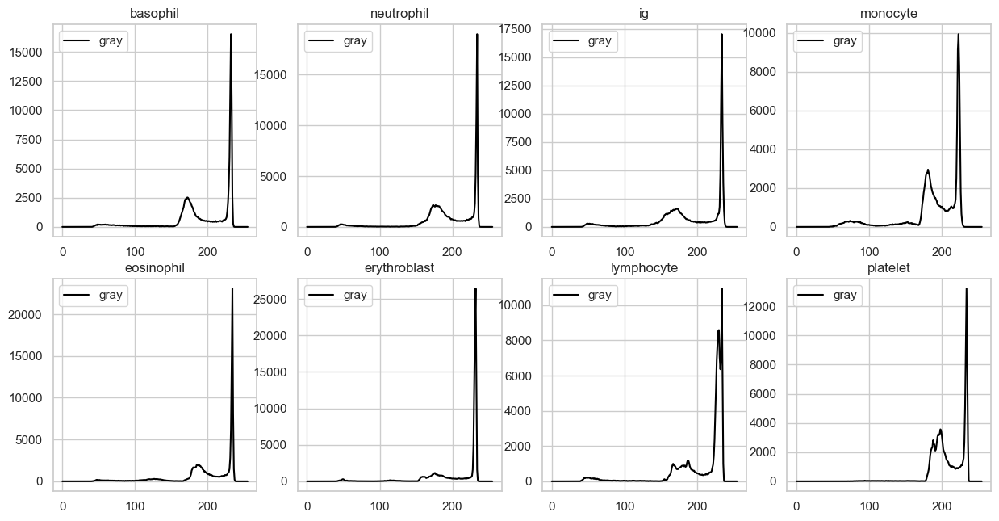

In [14]:
plt.figure(figsize=(15,7.5))
for id_cat, cat in enumerate(df_infos['category'].unique()):
    HISTR_GREY = []
    for path_image in df_infos['path_image'][df_infos['category'] == cat]:                
        img_GREY = cv2.imread(path_image, cv2.IMREAD_GRAYSCALE) 
        hist_grey= cv2.calcHist([img_GREY],[0],None,[256],[0,256])
    HISTR_GREY.append(hist_grey)                                    # creation d'une liste contenant tous les histogrammes/dossier
    HISTR_GREY = np.concatenate(HISTR_GREY, axis=1)                #concatenation des arrays histo en colonnes (1 col/256 lignes)
    HISTR_GREY = np.mean(HISTR_GREY, axis=1)                       #Moyennage de l'array conconténée
    plt.subplot(2,4,id_cat+1)
    plt.plot(HISTR_GREY,color = 'black') 
    plt.title(cat)
    plt.legend(["gray"], loc = 'best')

### Visualisation de l'histogramme des couleurs pour chaque échantillon HSV de chaque catégorie

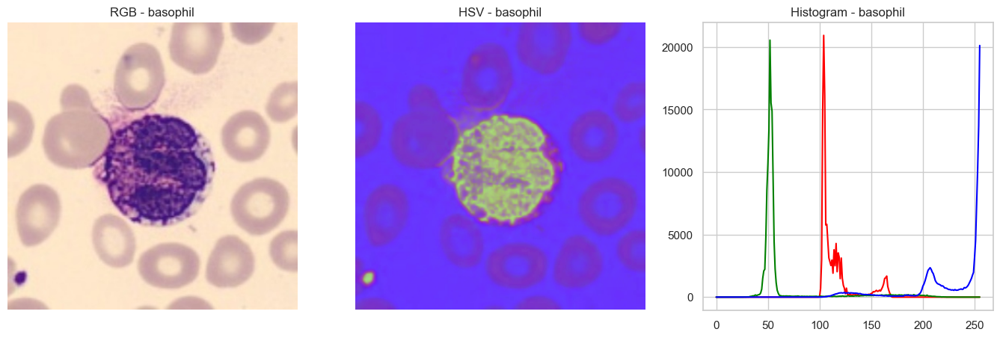

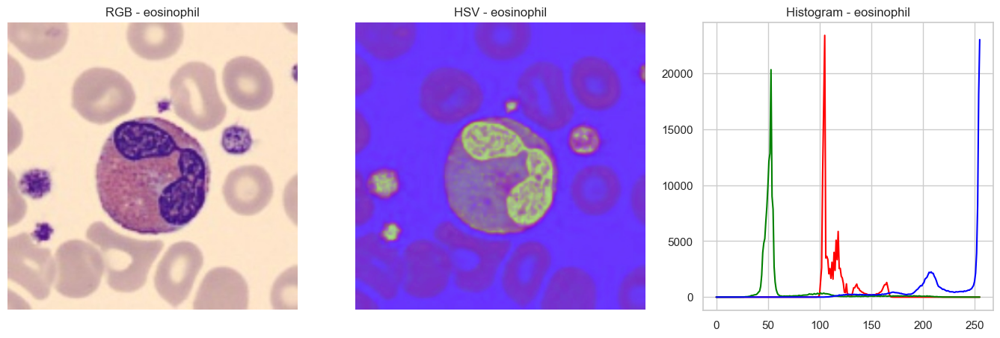

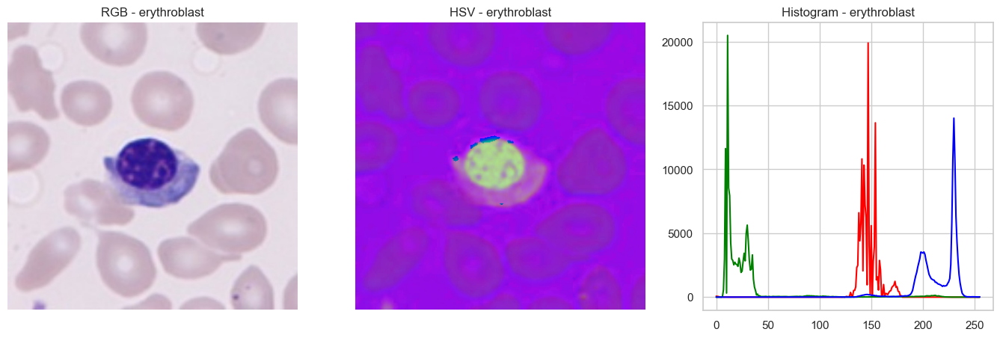

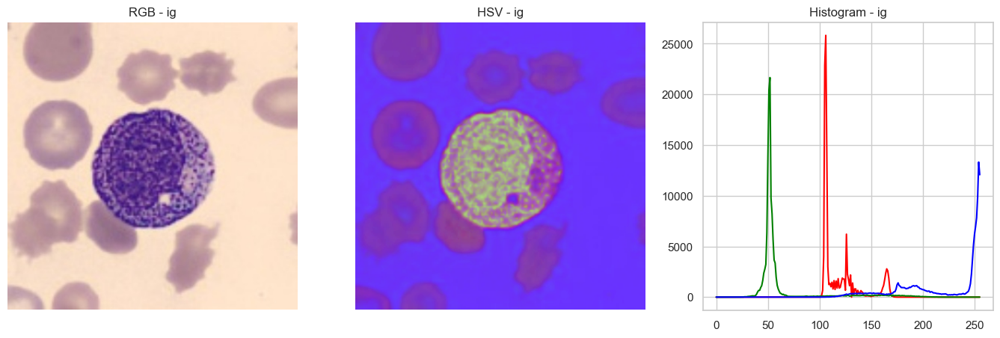

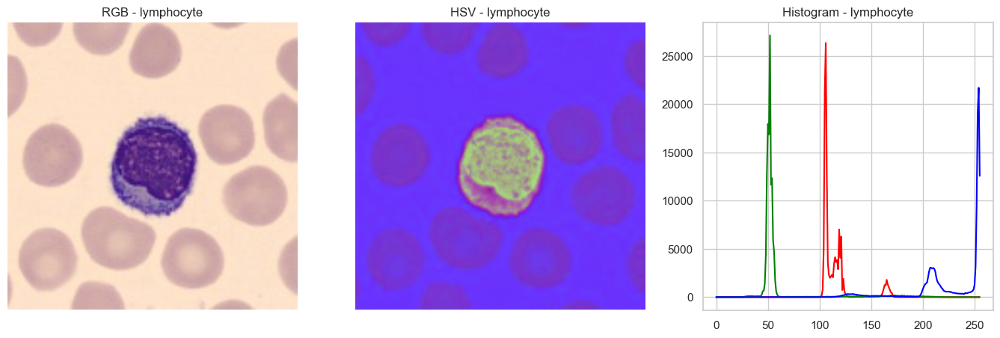

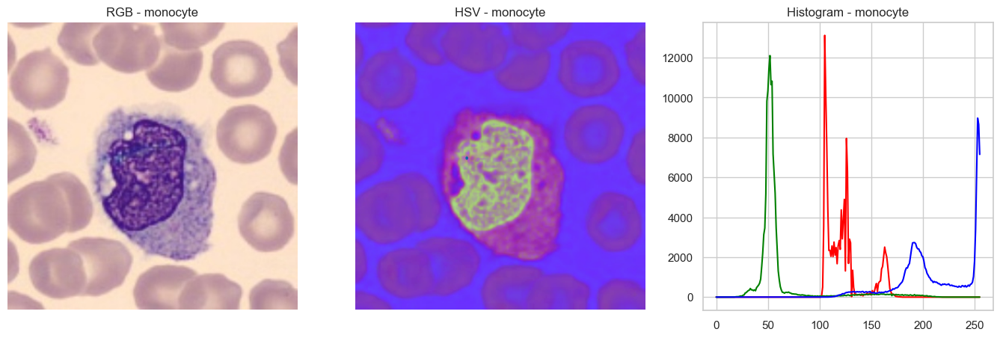

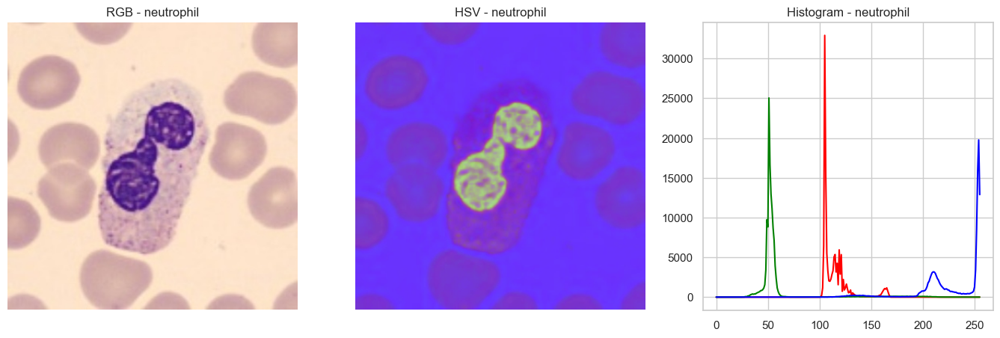

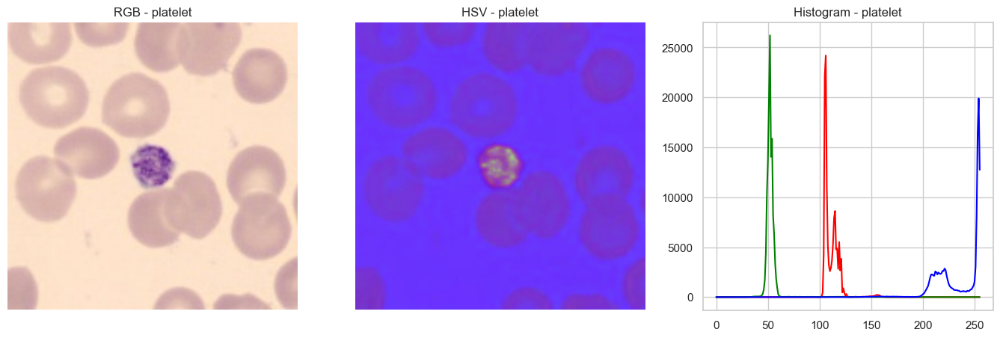

In [15]:
for i, path_image in enumerate(img_random['path_image']):
    plt.figure(figsize=(17,5))
    
    plt.subplot(1,3,1)
    img = cv2.imread(path_image, cv2.IMREAD_COLOR)
    img_color = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.imshow(img_color)
    plt.title(f"RGB - {img_random['category'][i]}")
    plt.axis('off')    

    plt.subplot(1,3,2)
    img_hsv = cv2.cvtColor(img_color, cv2.COLOR_BGR2HSV)
    plt.imshow(img_hsv)
    plt.title(f"HSV - {img_random['category'][i]}")
    plt.axis('off')
 
    plt.subplot(1,3,3)
    color = ("red", "green", "blue")
    for (j, color) in enumerate(("red", "green", "blue")):
        histr = cv2.calcHist([img_hsv],[j],None,[256],[0,256])
        plt.plot(histr,color = color)
        plt.title(f"Histogram - {img_random['category'][i]}")

### Visualisation des histogrammes moyens des couleurs pour tous les échantillons HSV de chaque categorie

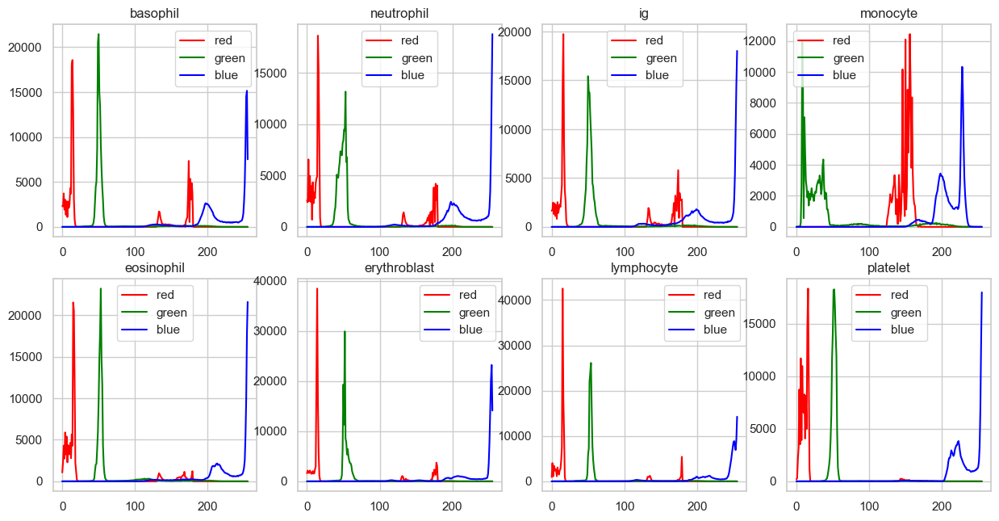

In [16]:
plt.figure(figsize=(15,7.5))
for id_cat, cat in enumerate(df_infos['category'].unique()):
    rgbcolors = ('red', 'green', 'blue')
    HISTR_COLOR = [[],[],[]]
    for color_id, color in enumerate(rgbcolors):
        for path_image in df_infos['path_image'][df_infos['category'] == cat]:                
            img_BGR = cv2.imread(path_image) 
            img_HSV = cv2.cvtColor(img_BGR, cv2.COLOR_BGR2HSV)
            histr_color = cv2.calcHist([img_HSV],[color_id],None,[256],[0,256])
        HISTR_COLOR[color_id].append(histr_color)                                    # creation d'une liste contenant tous les histogrammes/dossier
        HISTR_COLOR[color_id]= np.concatenate(HISTR_COLOR[color_id], axis=1)                #concatenation des arrays histo en colonnes (1 col/256 lignes)
        HISTR_COLOR[color_id]= np.mean(HISTR_COLOR[color_id], axis=1)                       #Moyennage de l'array conconténée
    plt.subplot(2,4,id_cat+1)
    plt.plot(HISTR_COLOR[0],color = rgbcolors[0], label = rgbcolors[0])
    plt.plot(HISTR_COLOR[1],color = rgbcolors[1], label = rgbcolors[1])  
    plt.plot(HISTR_COLOR[2],color = rgbcolors[2], label = rgbcolors[2])  
    plt.title(cat)
    plt.legend(loc = 'best')

### Visualisation de l'histogramme des couleurs pour chaque échantillon LAB de chaque catégorie

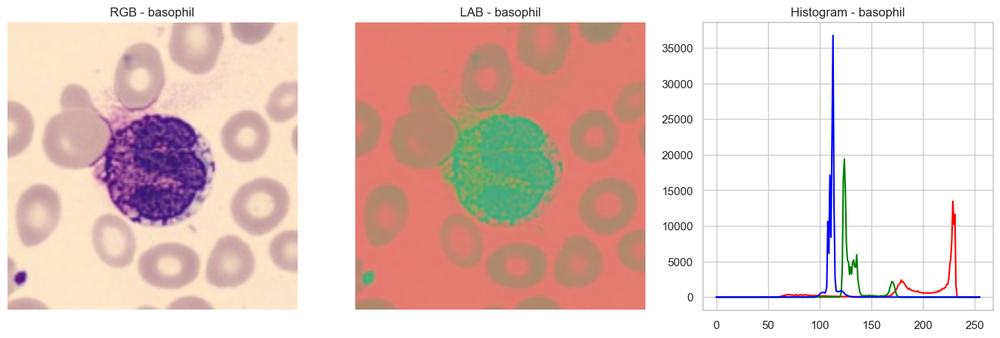

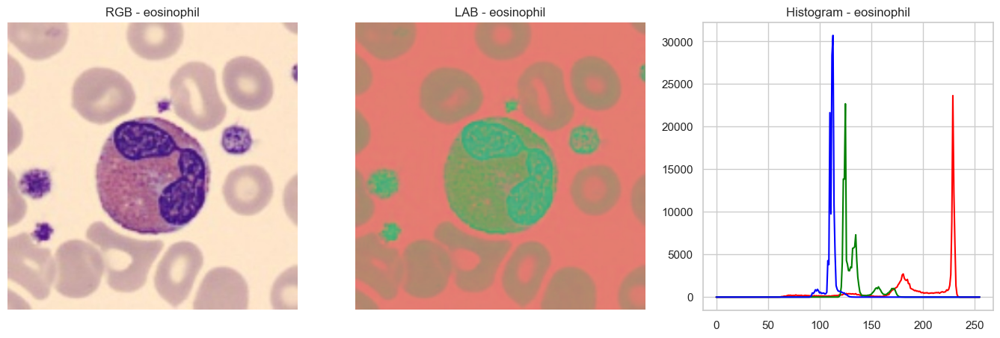

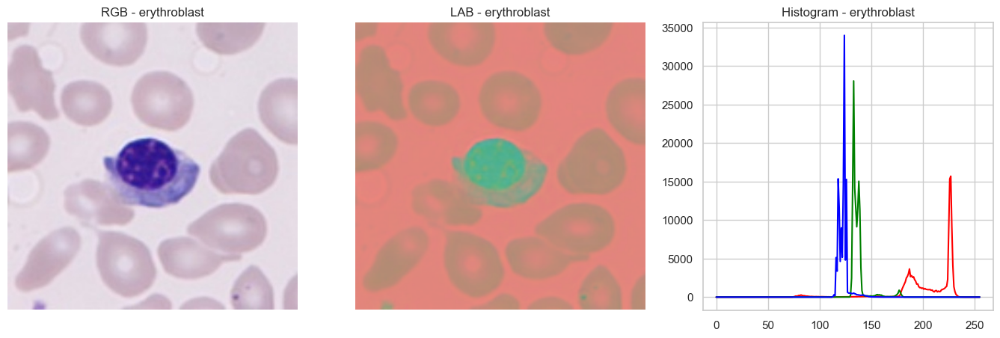

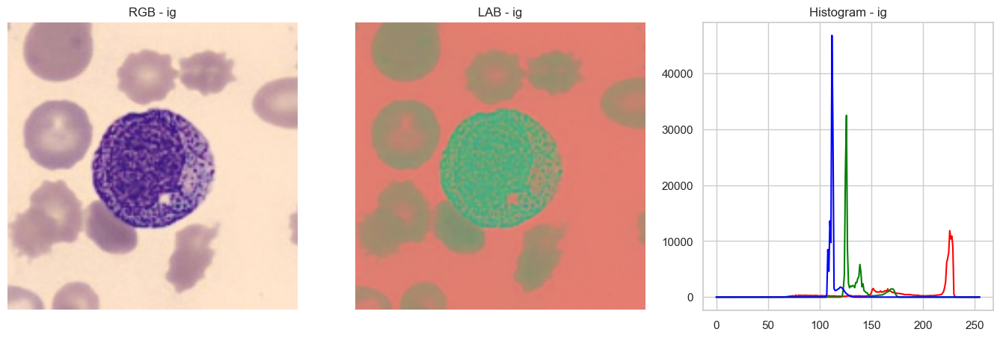

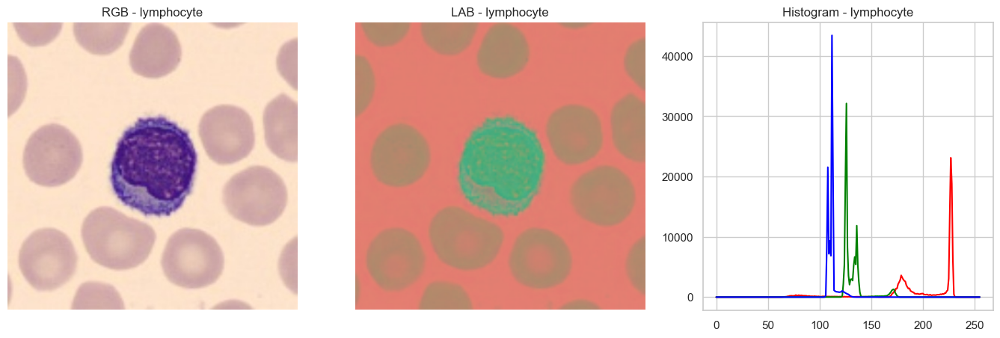

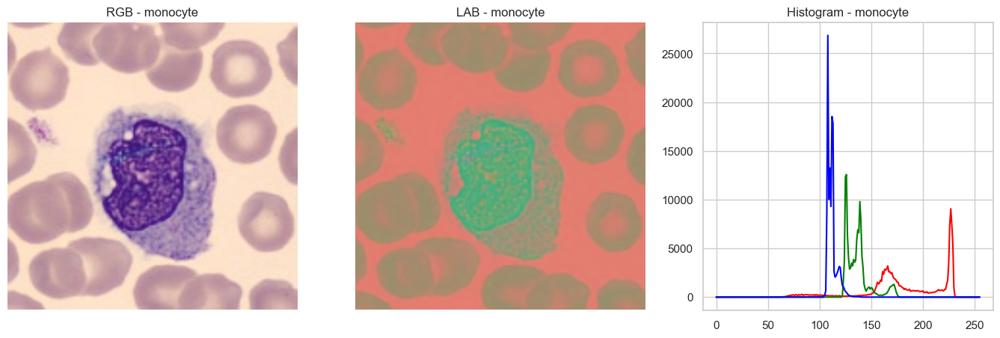

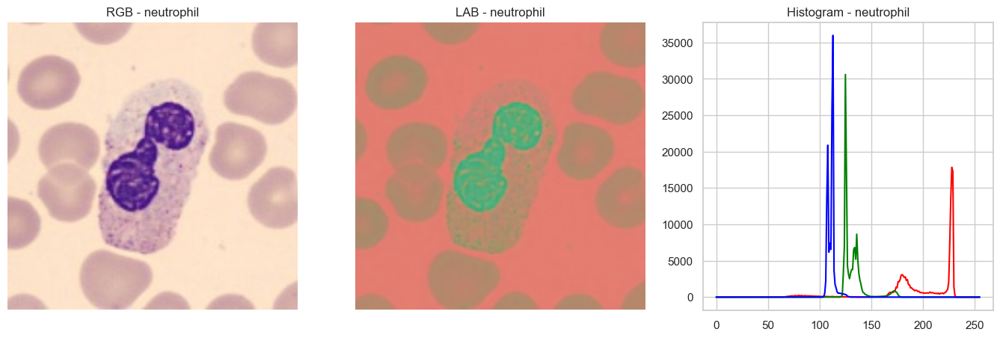

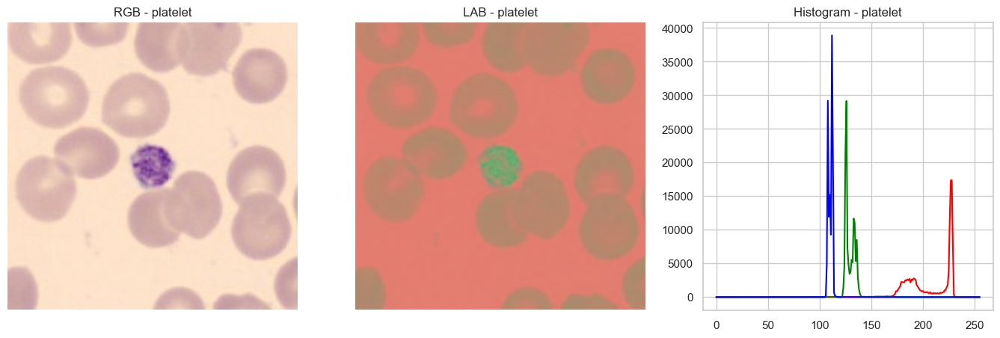

In [17]:
for i, path_image in enumerate(img_random['path_image']):
    plt.figure(figsize=(17,5))

    plt.subplot(1,3,1)
    img = cv2.imread(path_image)
    img_color = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.imshow(img_color)
    plt.title(f"RGB - {img_random['category'][i]}")
    plt.axis('off')

    plt.subplot(1,3,2)
    img_lab = cv2.cvtColor(img_color, cv2.COLOR_BGR2LAB)
    plt.imshow(img_lab)
    plt.title(f"LAB - {img_random['category'][i]}")
    plt.axis('off')
     
    plt.subplot(1,3,3)
    color = ("red", "green", "blue")
    for (j, color) in enumerate(("red", "green", "blue")):
        histr = cv2.calcHist([img_lab],[j],None,[256],[0,256])
        plt.plot(histr,color = color)
        plt.title(f"Histogram - {img_random['category'][i]}")

### Visualisation des histogrammes moyens des couleurs pour tous les échantillons LAB de chaque categorie

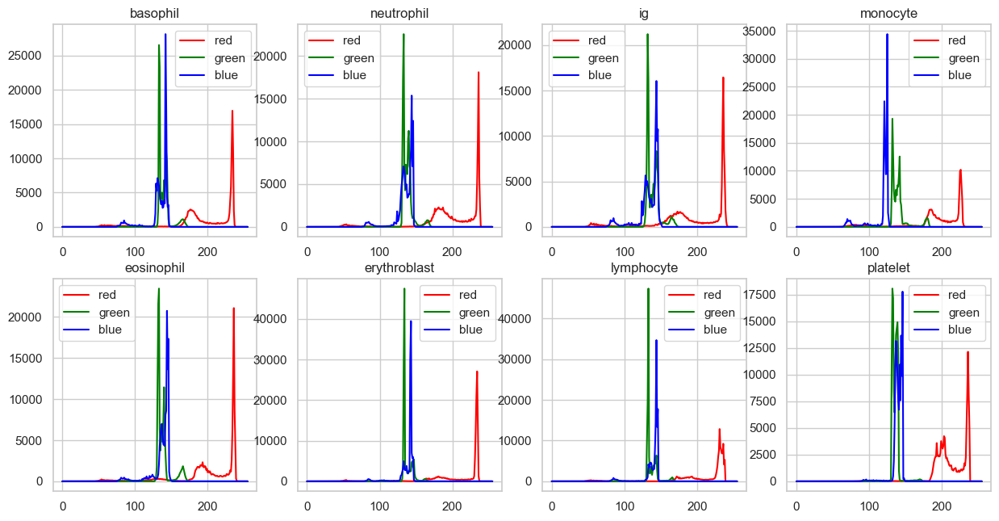

In [18]:
plt.figure(figsize=(15,7.5))
for id_cat, cat in enumerate(df_infos['category'].unique()):
    rgbcolors = ('red', 'green', 'blue')
    HISTR_COLOR = [[],[],[]]
    for color_id, color in enumerate(rgbcolors):
        for path_image in df_infos['path_image'][df_infos['category'] == cat]:                
            img_BGR = cv2.imread(path_image) 
            img_LAB = cv2.cvtColor(img_BGR, cv2.COLOR_BGR2LAB)
            histr_color = cv2.calcHist([img_LAB],[color_id],None,[256],[0,256])
        HISTR_COLOR[color_id].append(histr_color)                                    # creation d'une liste contenant tous les histogrammes/dossier
        HISTR_COLOR[color_id]= np.concatenate(HISTR_COLOR[color_id], axis=1)                #concatenation des arrays histo en colonnes (1 col/256 lignes)
        HISTR_COLOR[color_id]= np.mean(HISTR_COLOR[color_id], axis=1)                       #Moyennage de l'array conconténée
    plt.subplot(2,4,id_cat+1)
    plt.plot(HISTR_COLOR[0],color = rgbcolors[0], label = rgbcolors[0])
    plt.plot(HISTR_COLOR[1],color = rgbcolors[1], label = rgbcolors[1])  
    plt.plot(HISTR_COLOR[2],color = rgbcolors[2], label = rgbcolors[2])  
    plt.title(cat)
    plt.legend()

# Data Processing

### Resize des images

In [19]:
df_infos

,path_image,category,name,extension,width,height,dim,size
0,PBC_dataset_normal_DIB/basophil/BA_689200.jpg,basophil,BA_689200,jpg,363,360,3,363 x 360
1,PBC_dataset_normal_DIB/basophil/BA_883452.jpg,basophil,BA_883452,jpg,363,360,3,363 x 360
2,PBC_dataset_normal_DIB/basophil/BA_382161.jpg,basophil,BA_382161,jpg,369,366,3,369 x 366
3,PBC_dataset_normal_DIB/basophil/BA_175579.jpg,basophil,BA_175579,jpg,363,360,3,363 x 360
4,PBC_dataset_normal_DIB/basophil/BA_775722.jpg,basophil,BA_775722,jpg,363,360,3,363 x 360
...,...,...,...,...,...,...,...,...
17087,PBC_dataset_normal_DIB/platelet/PLATELET_49591...,platelet,PLATELET_495918,jpg,363,360,3,363 x 360
17088,PBC_dataset_normal_DIB/platelet/PLATELET_89723...,platelet,PLATELET_897238,jpg,363,360,3,363 x 360
17089,PBC_dataset_normal_DIB/platelet/PLATELET_75043...,platelet,PLATELET_750430,jpg,363,360,3,363 x 360
17090,PBC_dataset_normal_DIB/platelet/PLATELET_81043...,platelet,PLATELET_810431,jpg,363,360,3,363 x 360


In [20]:
for path_image in df_infos['path_image']:
    img = cv2.imread(path_image)
    if(img.shape != (363,360,3)):
        resized = cv2.resize(img, (363,360),interpolation = cv2.INTER_LINEAR)
        cv2.imwrite(str(path_image),resized)
    else:
        pass

### Etude des contours

##### Canny

In [21]:
from skimage.feature import canny

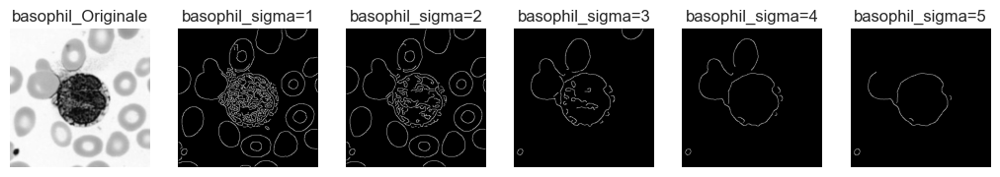

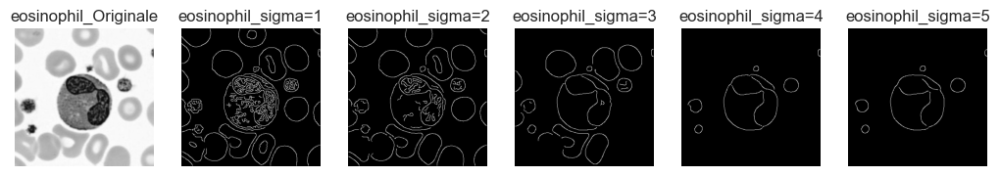

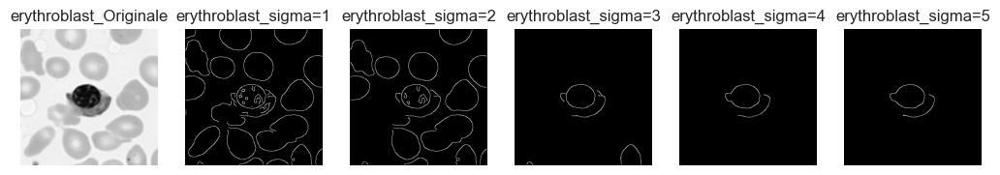

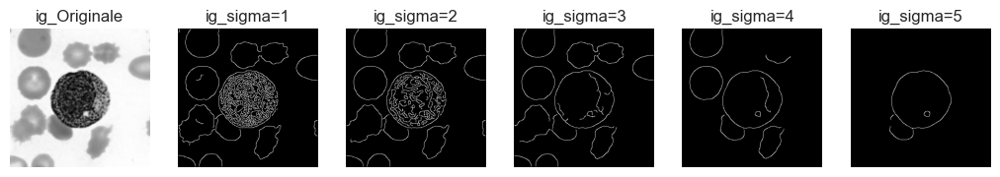

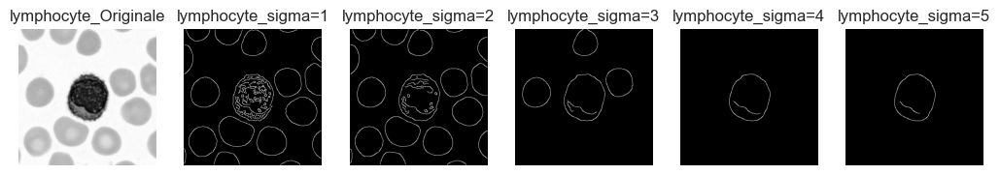

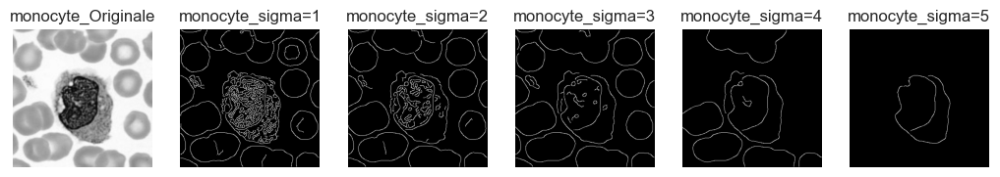

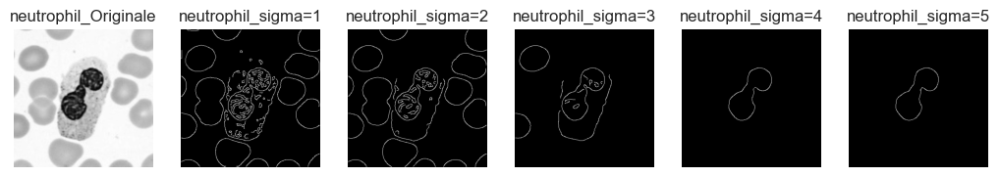

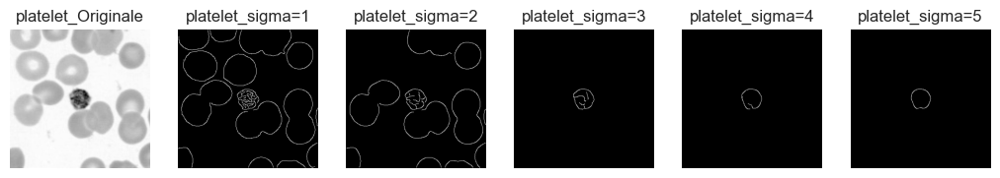

In [22]:
for i, path_image in enumerate(img_random['path_image']):
    plt.figure(figsize=(15, 7.5))
    plt.subplot(1,7,1)
    img = cv2.imread(path_image, cv2.IMREAD_GRAYSCALE)
    plt.imshow(img,cmap = 'gray')
    plt.axis('off')
    plt.title(f"{img_random['category'][i]}_Originale")
    
    for j in range(1,6):
        plt.subplot(1,7,j+1)
        edges = canny(img,sigma=j)
        plt.imshow(edges,cmap = 'gray')
        plt.title(f"{img_random['category'][i]}_sigma={j}")
        plt.axis('off')

##### K_Means

In [23]:
from sklearn.cluster import KMeans

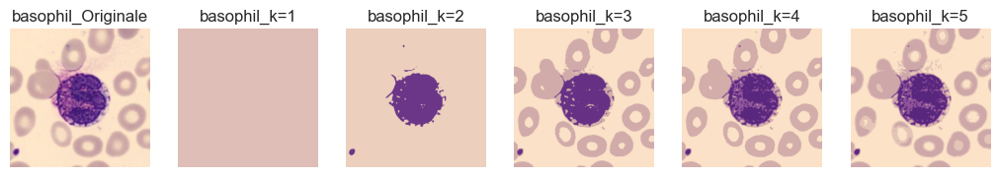

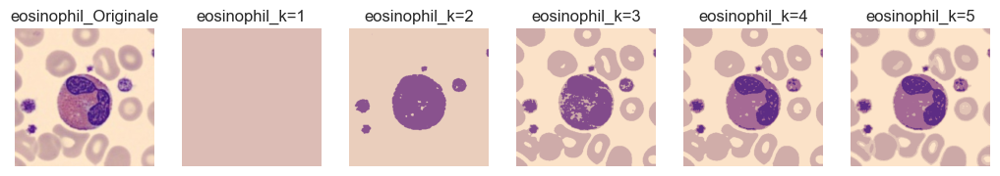

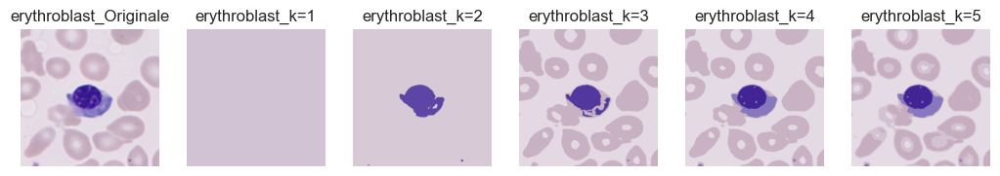

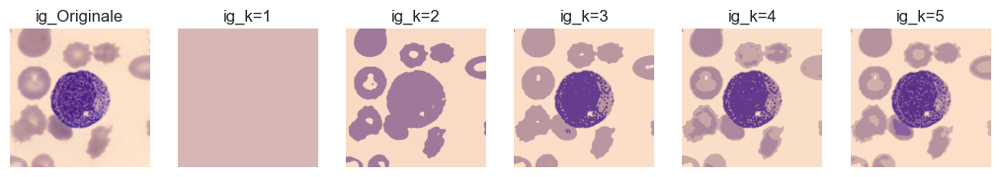

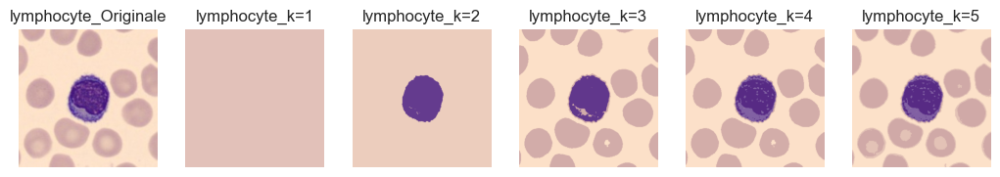

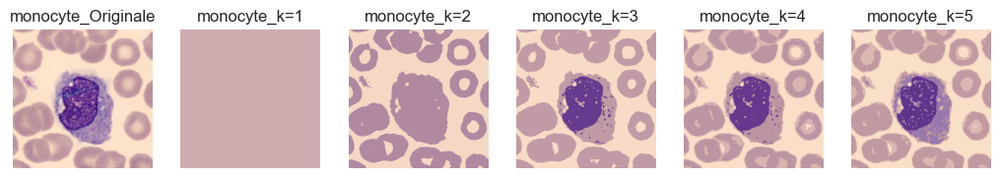

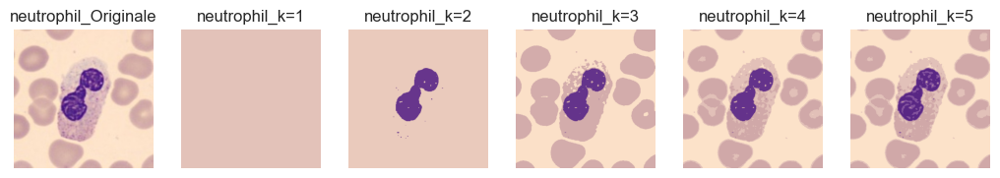

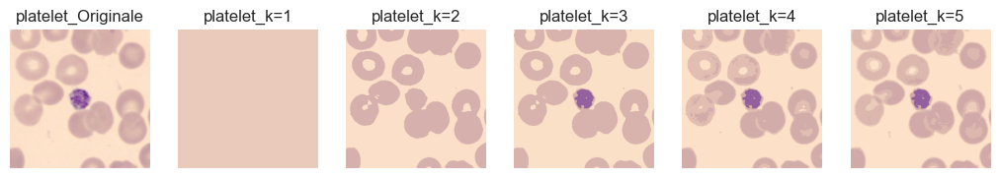

In [39]:
for i, path_image in enumerate(img_random['path_image']):
    plt.figure(figsize=(15, 7.5))
    plt.subplot(1,7,1)
    img = cv2.imread(path_image, cv2.IMREAD_COLOR)
    img_color = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.imshow(img_color)
    plt.axis('off')
    plt.title(f"{img_random['category'][i]}_Originale")
    
    for j in range(1,6):
        plt.subplot(1,7,j+1)
        img_flatted = img_color.reshape(img_color.shape[0]*img_color.shape[1],img_color.shape[2])
        kmeans = KMeans(j).fit(img_flatted)
        centroids = kmeans.cluster_centers_.astype(int)
        labels = kmeans.labels_
        img_recovered = centroids[labels].reshape(img_color.shape)
        plt.imshow(img_recovered)
        plt.title(f"{img_random['category'][i]}_k={j}")
        plt.axis('off')

In [25]:
img_flatted.shape

(130680, 3)

##### MeanShift

In [26]:
from sklearn.cluster import MeanShift, estimate_bandwidth

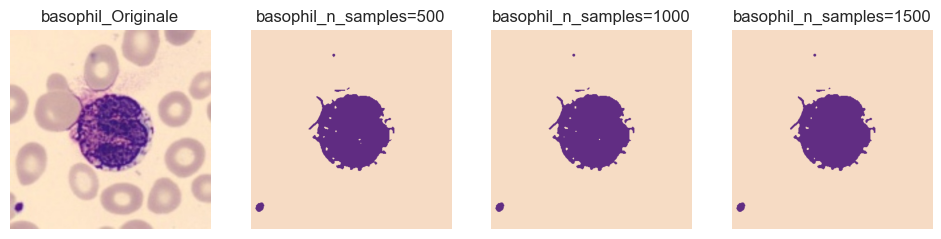

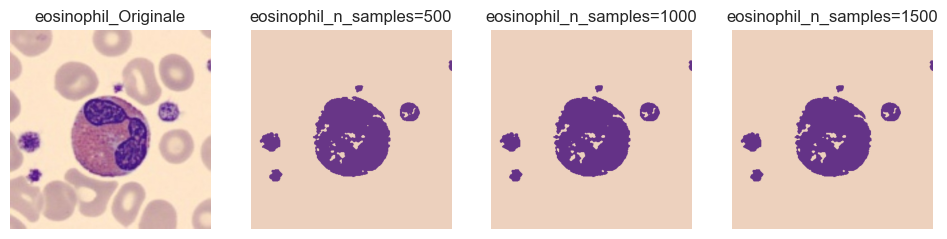

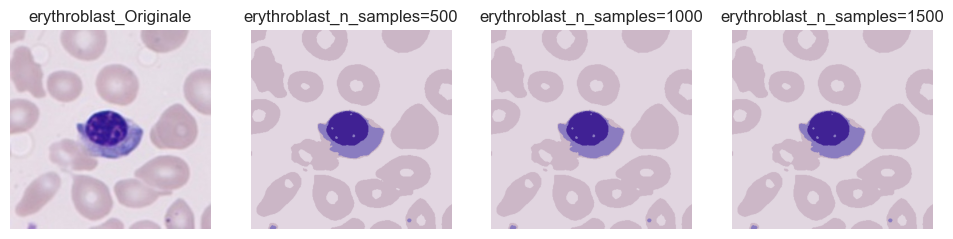

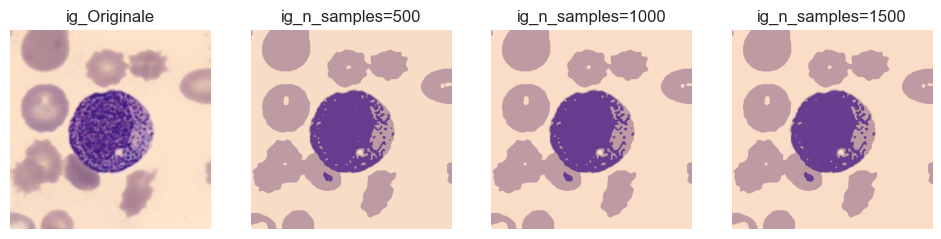

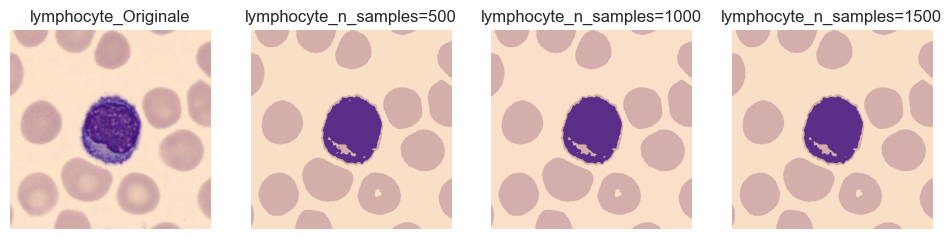

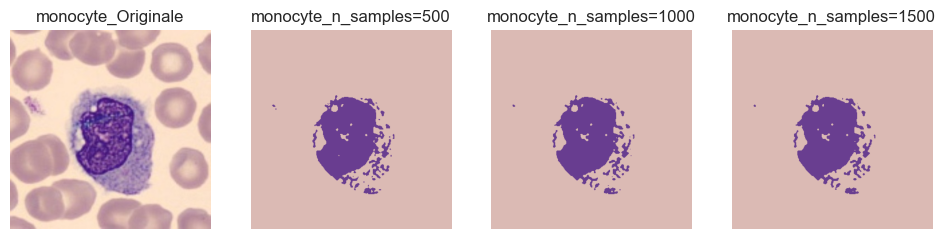

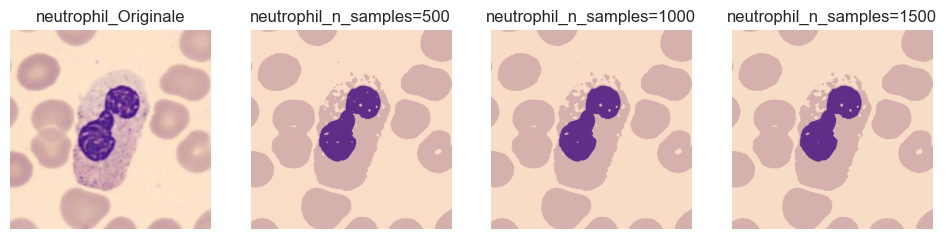

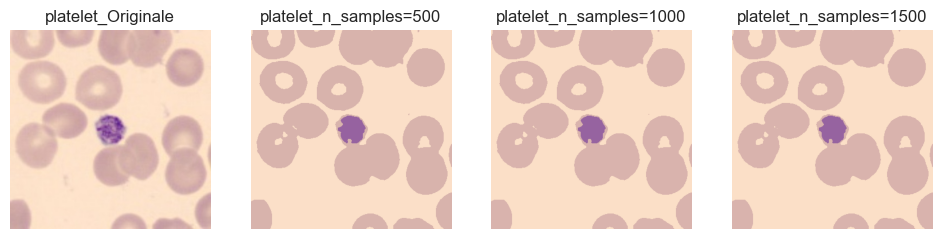

In [27]:
for i, path_image in enumerate(img_random['path_image']):
    plt.figure(figsize=(15, 7.5))
    plt.subplot(1,5,1)
    img = cv2.imread(path_image, cv2.IMREAD_COLOR)
    img_color = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.imshow(img_color)
    plt.axis('off')
    plt.title(f"{img_random['category'][i]}_Originale")
    
    for j in range(1,4):
        plt.subplot(1,5,j+1)    
        img_color = cv2.medianBlur(img_color, 3)     # On applique un filtre pour réduire le possible bruit de l'image
        img_flatted = img_color.reshape(img_color.shape[0]*img_color.shape[1], img_color.shape[2])

        bandwidth = estimate_bandwidth(img_flatted, quantile=0.5, n_samples=1000*j)
        ms = MeanShift(bandwidth=bandwidth,max_iter=500,bin_seeding=True)
        ms = ms.fit(img_flatted)
        labels=ms.labels_                                   # Pour chaque pixel, on récupere le label estimé.
        centroids = ms.cluster_centers_  

        centroids = np.uint8(centroids)
        img_recovered = centroids[labels]
        img_recovered = img_recovered.reshape(img_color.shape)
        plt.imshow(img_recovered)
        plt.title(f"{img_random['category'][i]}_n_samples={500*j}")
        plt.axis('off')
    

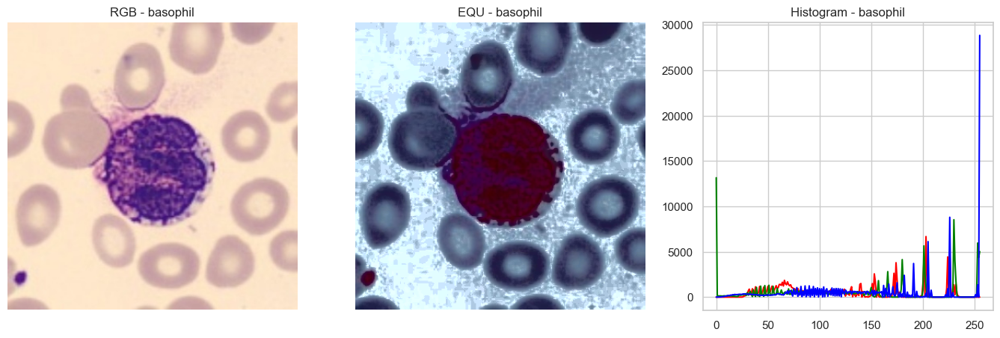

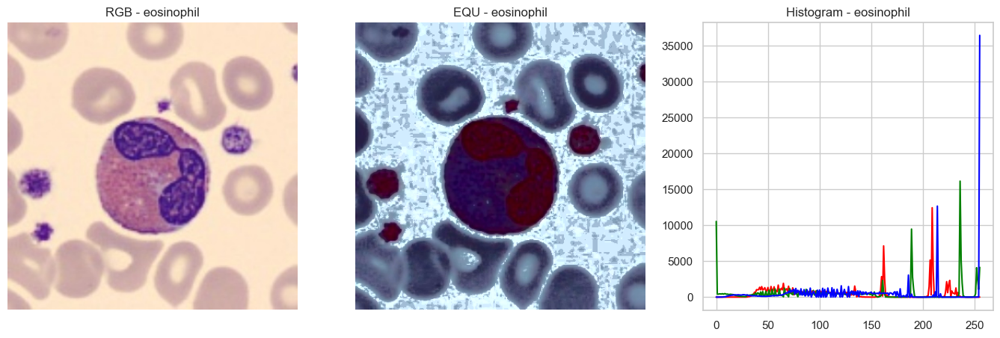

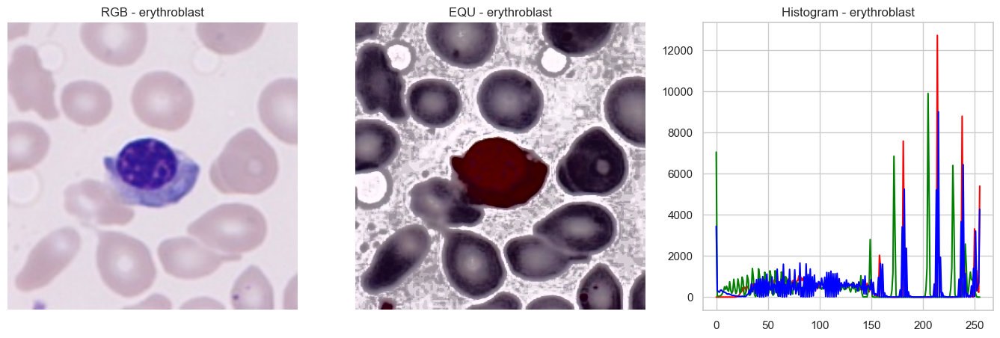

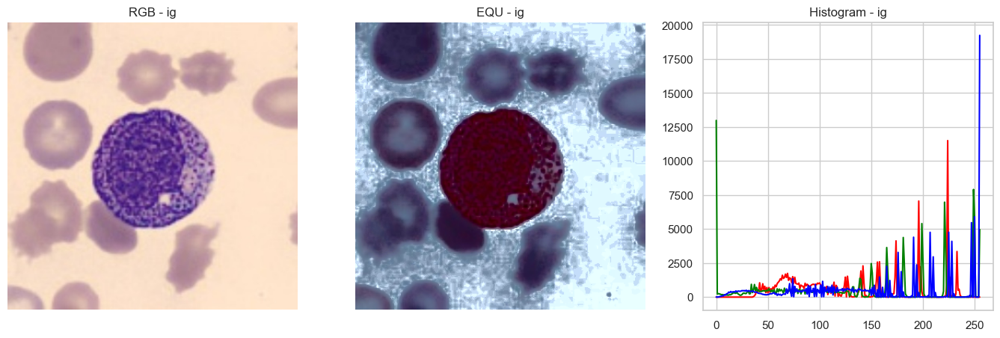

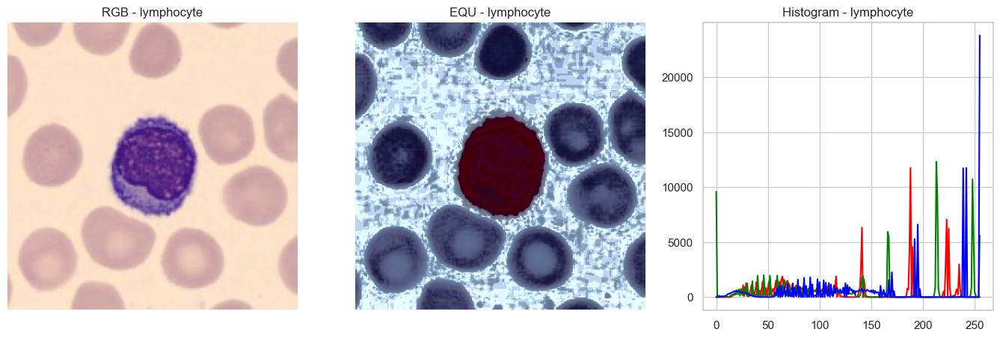

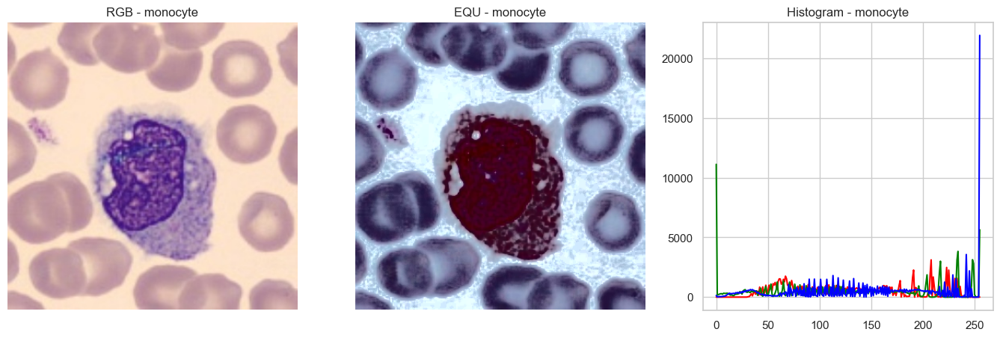

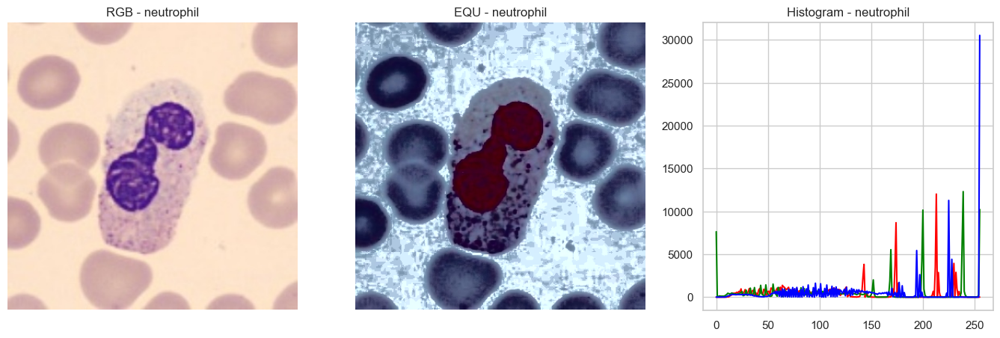

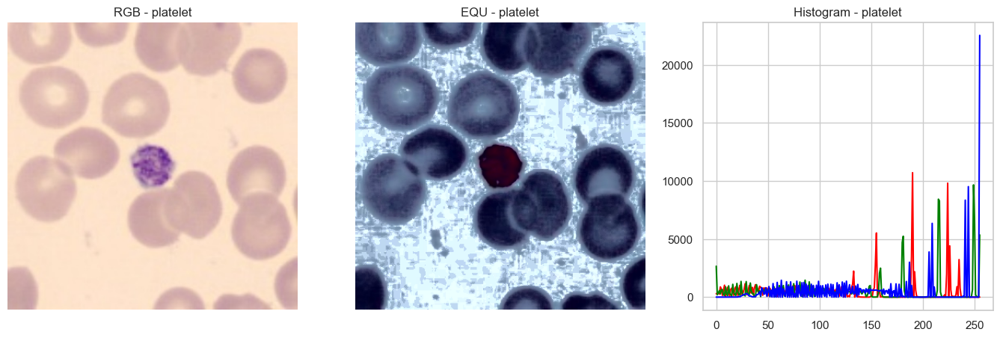

In [28]:
for i, path_image in enumerate(img_random['path_image']):
    plt.figure(figsize=(17,5))

    plt.subplot(1,3,1)
    img = cv2.imread(path_image, cv2.IMREAD_COLOR)
    img = cv2.cvtColor(img,cv2.COLOR_BGR2RGB)
    
    plt.imshow(img)
    plt.title(f"RGB - {img_random['category'][i]}")
    plt.axis('off')

    plt.subplot(1,3,2)
    # Egalisation de l'image
    img_yuv = cv2.cvtColor(img,cv2.COLOR_BGR2YUV)
    img_yuv[:,:,0] = cv2.equalizeHist(img_yuv[:,:,0])
    img_equ = cv2.cvtColor(img_yuv, cv2.COLOR_YUV2RGB)
    plt.imshow(img_equ)
    plt.title(f"EQU - {img_random['category'][i]}")
    plt.axis('off')
     
    plt.subplot(1,3,3)
    color = ("red", "green", "blue")
    for (j, color) in enumerate(("red", "green", "blue")):
        histr = cv2.calcHist([img_equ],[j],None,[256],[0,256])
        plt.plot(histr,color = color)
        plt.title(f"Histogram - {img_random['category'][i]}")

# Nettoyage du Background

##  Filtrage du background par couleur

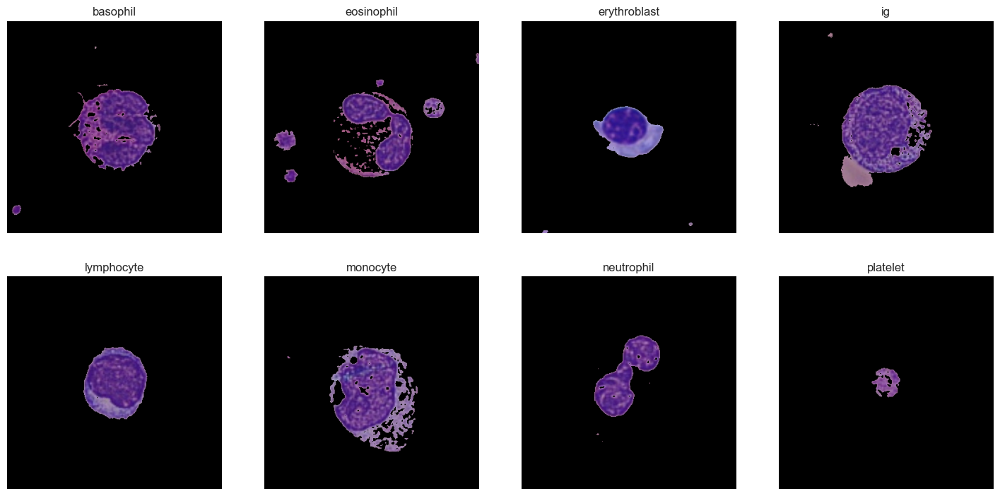

In [29]:
figure = plt.figure(figsize=(18,18)) 

filtered_image = []
for i, path_image in enumerate(img_random['path_image']):
    img = cv2.imread(path_image)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB) # on peut le faire en HSV et en LAB
    lower_color = np.array([30, 0, 0])
    upper_color = np.array([165,255,255])
    mask_color = cv2.inRange(img, lower_color, upper_color)
    res_red = cv2.bitwise_and(img,img, mask= mask_color)
    plt.subplot(4,4,i+1)
    plt.imshow(res_red);
    plt.title(f"{img_random['category'][i]}")
    plt.axis('off')
    filtered_image.append(res_red)


> **Cette méthode donne des résultats beaucoup mieux que la précédente, on arrive à bien resortir la cellule qui nous interesse.**

# 6. Segmentation en utilisant K-means et Mean Shift

## 6.1. K-Means clustering avec OpenCV

###  i. Images filtrées par couleur

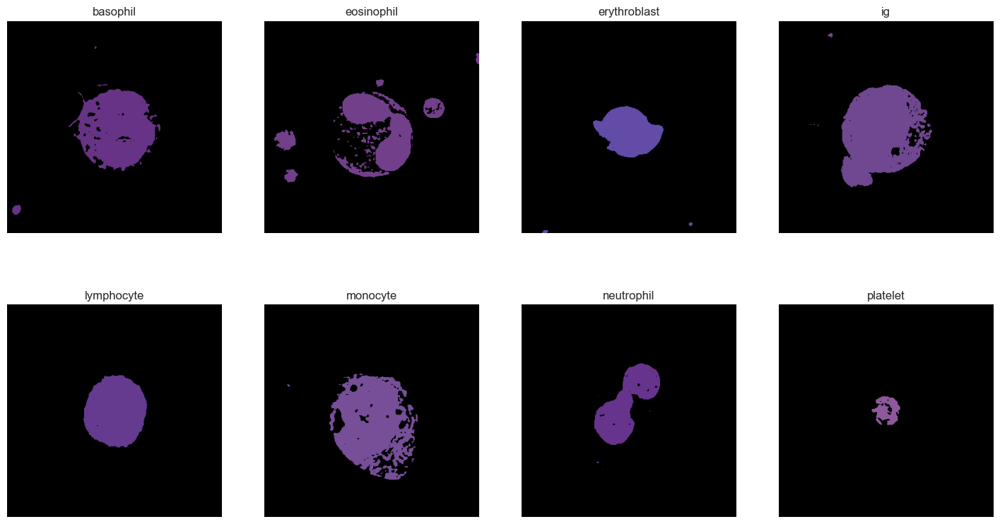

In [30]:
#############----------------- K-MEANS sur les images à qui on a nettoyé le background en amont-----------------############# 

Z = [] ## Créer une liste où stocker nos images redimentionner
Clustered_img = [] 

for i, path_image in enumerate(img_random['path_image']):
    img =filtered_image[i] # Img_cleaned
    
    # redimentionner l'image en un array à deux dimension (hauteur*lrgeur,coleur)
    z = img.reshape((-1,3))   
    
    # convertir de le type de l'array en 'float32' afin que les Kmeans de OpenCV le prenne en compte
    z = np.float32(z) 
    Z.append(z)
    # définir les critéres, nombre de clusters (K) et ensuite appliquer les K-Means
    criteria = (cv2.TermCriteria_EPS + cv2.TermCriteria_MAX_ITER, 10, 1.0)
    K = 2 # on met le nombre de clusters = 2 pour juste sortir les cellule
    
    # mettre les sorties de cv2.kmeans dans rets, labels, centroids
    rets , labels , centroids = cv2.kmeans(z, K, None, criteria, 10, cv2.KMEANS_PP_CENTERS)
 
    # revenir à la dimensions originale pour pouvoir afficher l'image
    centroids = np.uint8(centroids)
    res = centroids[labels.flatten()]
    res2 = res.reshape((img.shape))
    Clustered_img.append(res2)

fig= plt.figure(figsize=(18,20))   
for i in range(8):        
    # subplots
    plt.subplot(4, 4, i+1)   
    # Afficher l'image  
    plt.imshow(Clustered_img[i])
    # set the title to subplots
    plt.title(f"{img_random['category'][i]}")
    plt.axis('off')

### iii. Etude Kmeans pour extraction de la cellule cible

In [31]:
img_info = pd.read_csv('img_info.csv')
cell_types = pd.read_csv('cell_types.csv')
# cell_types = cell_types[cell_types.Source=='article'].drop(columns=['Source'])
df = pd.merge(img_info,cell_types,how='outer') # merge on column cell_subtype
print(len(df),len(img_info))

17092 17092


In [32]:
from sklearn.cluster import KMeans

def KMeans_convert(img,n_clusters=6,bckgrd=True):
    """
    img : image in RGB
    n_clusters : nombre de clusters du Kmeans
    bckgrd : appliquer un filtre kmeans 2 sur le background ou non
    
    Description:
    Cette fonction applique un Kmeans pour K=6 qui regroupe les couleurs de l'image en 6 groupes, puis, parmi les centroïdes calculés, 
    on redéfinit 2 groupes de centroïdes en forçant le départ de l'algorithme à une couleur proche du fond et de la couleur des globules rouges.
    Parmi les 2 groupes de couleurs obtenus, le premier groupe correspondra donc au fond et aux globules rouges, que l'on fait apparaître en blanc.

    """
    
    start = time.time()                                                        # start timer
    h,w,c=img.shape                                                            # get image dimensions
    X=img.reshape(h*w,c)                                                       # reshape the image to an array (nb_pixels x canals)
    cluster=KMeans(n_clusters=n_clusters)                                      # KMeans instanciation
    cluster.fit(X)                                                             # KMeans training
    labels=cluster.labels_                                                     # Label for each pixel
    centroids = cluster.cluster_centers_                                       # K centroids
    
    if bckgrd==False:
        centroids_init = np.array([[252,227,199]                               # we force the algorithm to start with the label 0 centroid close to background color
                                   ,[69,24,130]])
        cluster2=KMeans(n_clusters=2,init=centroids_init,n_init=1).fit(centroids)                           # divide centroids in 2 clusters
        centroids[cluster2.labels_==0] = [255,255,255]                                # set up all centroids with label 0 to blank color
        # # centroids[cluster2.labels_==0] = cluster2.cluster_centers_[0]          # set up all centroids with label 0 to their centroid

    centroids = centroids.astype(int)
    X_recovered=centroids[labels]                                              # set-up each pixel to be equal to the centroid of its cluster
    img_recovered = X_recovered.reshape(h,w,c)                                 # reshape the array to the image initial dimensions
    end = time.time()                                                          # stop timer
    elapsed_time = end - start                                                 # elapsed time
    return img_recovered, elapsed_time, centroids


def ShowKmeansSample(df, sample_per_cell_type=1, n_clusters_range = [2,5,6,8,16]):
    
    nb_col = len(n_clusters_range)+1
    
    # index random selection:
    selected_index=[]
    for ct in df.category.unique(): 
        new_selected_index=np.random.choice(
                           df[df.category==ct].index                                         # parmis tous les indices du type de cellule
                           , size= sample_per_cell_type)                                           # on sélectionne un nombre sample_per_cell_type par type de cellule
        selected_index=np.concatenate([selected_index,new_selected_index]).astype(int)

    nb_images = len(selected_index)
    plt.figure(figsize = (nb_col*5, nb_images*5))
    
    for i, path_image in enumerate(img_random['path_image']):        
        img = cv2.imread(path_image,cv2.IMREAD_COLOR)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB) # conversion from BGR to RGB

        plt.subplot(nb_images,nb_col,nb_col*i+1)
        plt.imshow(img,cmap = 'gray')
        plt.xticks([]), plt.yticks([]), plt.title('Original\n'+df.loc[i,'category'])

        # perf=[]
        img_pos = nb_col*i + 2
        for n_clusters in n_clusters_range:
            img_recovered, elapsed,_ = KMeans_convert(img,n_clusters=n_clusters,bckgrd=False)
            # perf.append(elapsed)
            # print(f'Temps d\'exécution K Means {k:0} : {elapsed:0.2} s')
            plt.subplot(nb_images,nb_col,img_pos)
            plt.imshow(img_recovered,cmap = 'gray')
            plt.xticks([]), plt.yticks([]), plt.title(f'K Means (K={n_clusters:0})\nExecution time :{elapsed:0.2} s')
            img_pos+=1 


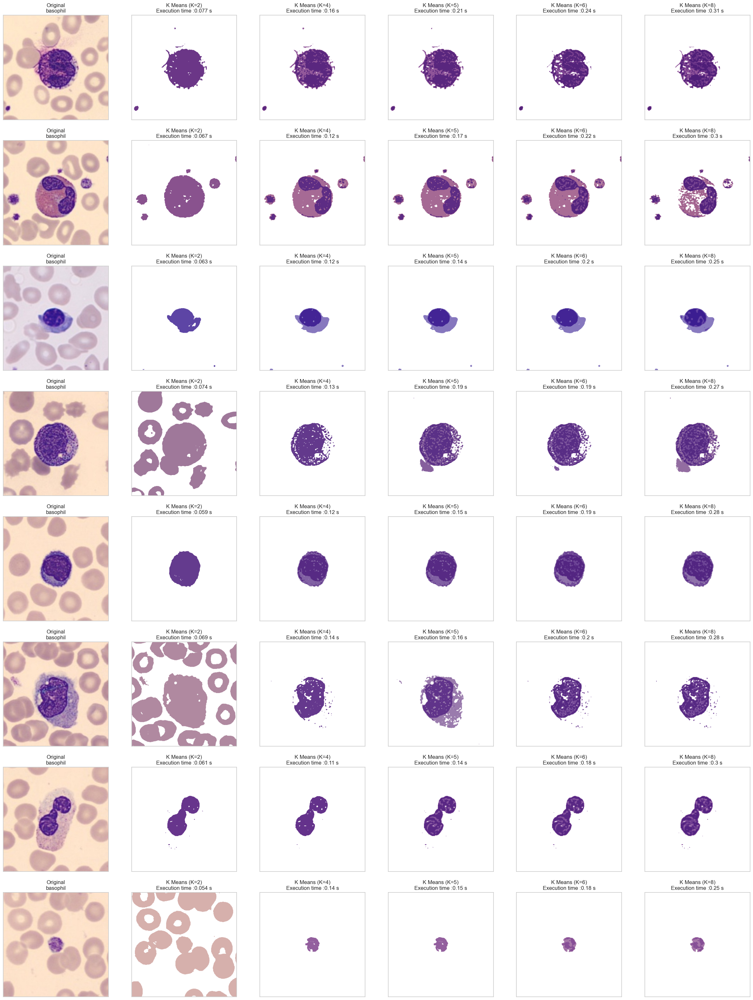

In [33]:
n_Kmeans_clusters = [2,4,5,6,8]
npc = 2
ShowKmeansSample(df_infos,sample_per_cell_type=npc,n_clusters_range = n_Kmeans_clusters)
plt.savefig('Analysis/Analysis_Kmeans_'+str(npc*8)+'cells_'+str(n_Kmeans_clusters).replace(',','x').replace(' ','').replace('[','').replace(']','')+'.jpg')

> On choisit le Kmeans avec la meilleure nuance et un temps d'execution "raisonnable" : K = 6

### iv. K Means sur les coordonnées X,Y,R,G,B

In [43]:

#X Y R G B
# faire un traitement d'images en X Y R G B pour la partie K-means et visualiser les centroids

def KMeansXYRGB_convert(img,n_clusters=10):
    """
    img : image in RGB
    
    Description:
    Cette fonction applique un Kmeans pour K=n_clusters qui regroupe les pixels par positions sur l'image et les 3 canaux de couleurs RGB
    A chaque pixel est appliqué ses coordonnées X, Y ainsi que ses intenistés lumineuses R,G,B.
    On soumet donc au Kmeans une matrice (363, 360, 5) où 5 représente le nombre de dimensions pour X,Y,R,G,B.
    
    """
    
    start = time.time()                                                        # start timer
    h,w,c=img.shape                                                            # get image dimensions
    XY = np.zeros([h,w,2])
    for x in range(h):                                                         # create matrix h,w,2 which gives X and Y coordinates of the pixel
        for y in range(w):
            XY[x,y] = [x,y]
    
    XY_img = np.concatenate([XY,img],axis=2)                                   # Concatenate the image with coordinates to create a matrix h,w,c+2 (c+2 = 5 coordinates X,Y,R,G,B)
    X = XY_img.reshape(h*w,c+2)                                                # reshape the image to an array (nb_pixels x canals)
    cluster=KMeans(n_clusters=n_clusters)                                      # KMeans instanciation
    cluster.fit(X)                                                             # KMeans training
    labels=cluster.labels_                                                     # Label for each pixel
    centroids = cluster.cluster_centers_                                       # K centroids

    centroids = centroids.astype(int)
    X_recovered=centroids[labels]                                              # set-up each pixel to be equal to the centroid of its cluster
    XY_img_recovered = X_recovered.reshape(h,w,c+2)                            # reshape the array to the XY_image dimensions
    img_recovered = XY_img_recovered[:,:,-3:]                                  # we get only RGB colors to reconstitute images
    end = time.time()                                                          # stop timer
    elapsed_time = end - start                                                 # elapsed time
    
    return img_recovered, elapsed_time, centroids


def Show_KmeansXYRGB_Sample(df, sample_per_cell_type=1, n_clusters_range = [10], show_centroids = True):
    
    nb_col = len(n_clusters_range)+1
    
    # index random selection:
    selected_index=[]
    for ct in df.category.unique(): 
        new_selected_index=np.random.choice(
                           df[df.category==ct].index                                         # parmis tous les indices du type de cellule
                           , size= sample_per_cell_type)                                           # on sélectionne un nombre sample_per_cell_type par type de cellule
        selected_index=np.concatenate([selected_index,new_selected_index]).astype(int)

    nb_images = len(selected_index)
    plt.figure(figsize = (nb_col*5, nb_images*5))
    
    for i, path_image in enumerate(img_random['path_image']):        

        img = cv2.imread(path_image,cv2.IMREAD_COLOR)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB) # conversion from BGR to RGB

        plt.subplot(nb_images,nb_col,nb_col*i+1)
        plt.imshow(img,cmap = 'gray')
        plt.xticks([]), 
        plt.yticks([]), 
        plt.title('Original\n'+df.loc[i,'category'])

        # perf=[]
        img_pos = nb_col*i + 2
        for n_clusters in n_clusters_range:
            img_recovered, elapsed, centroids = KMeansXYRGB_convert(img,n_clusters=n_clusters)
            
            plt.subplot(nb_images,nb_col,img_pos)
            plt.imshow(img_recovered,cmap = 'gray')
            if show_centroids:
                x_centroids = centroids[:,0]
                y_centroids = centroids[:,1]
                plt.scatter(x_centroids,y_centroids,color='red',marker = 'o', s= 30, alpha=0.8,edgecolor='red',linewidths=4)
            
            plt.xticks([]), plt.yticks([]), plt.title(f'K Means (K={n_clusters:0})\nExecution time :{elapsed:0.2} s')
            img_pos+=1 


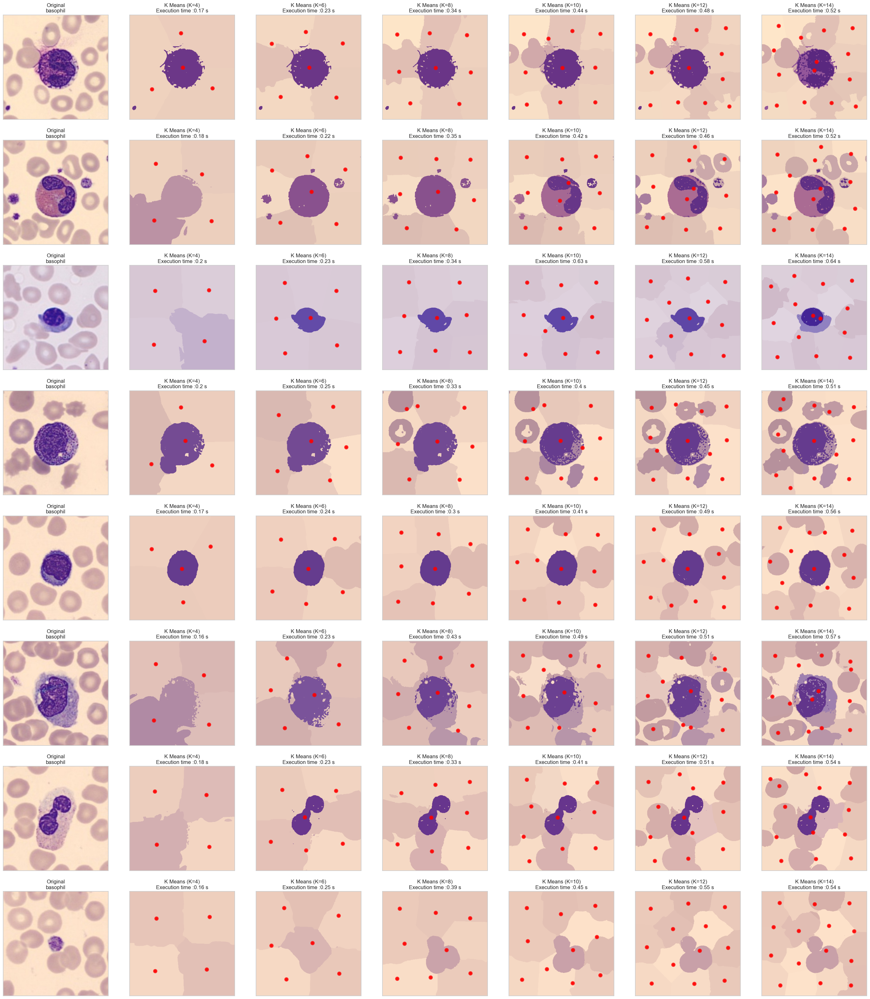

In [35]:
n_Kmeans_clusters = [4,6,8,10,12,14]
npc = 1
Show_KmeansXYRGB_Sample(df_infos,sample_per_cell_type=npc,n_clusters_range = n_Kmeans_clusters, show_centroids = True)
plt.savefig('Analysis/Analysis_KmeansXYRGB_'+str(npc*8)+'cells_'+str(n_Kmeans_clusters).replace(',','x').replace(' ','').replace('[','').replace(']','')+'.jpg')

> * Les résultats sont plutôt intéressants pour un K aux alentours de 10, malgré un temps d'execution important.
> * Un temps de préprocessing conséquent sera nécessaire.
> * étudions le meilleur paramètre K autour de 10, pour extraire un maximum de features.

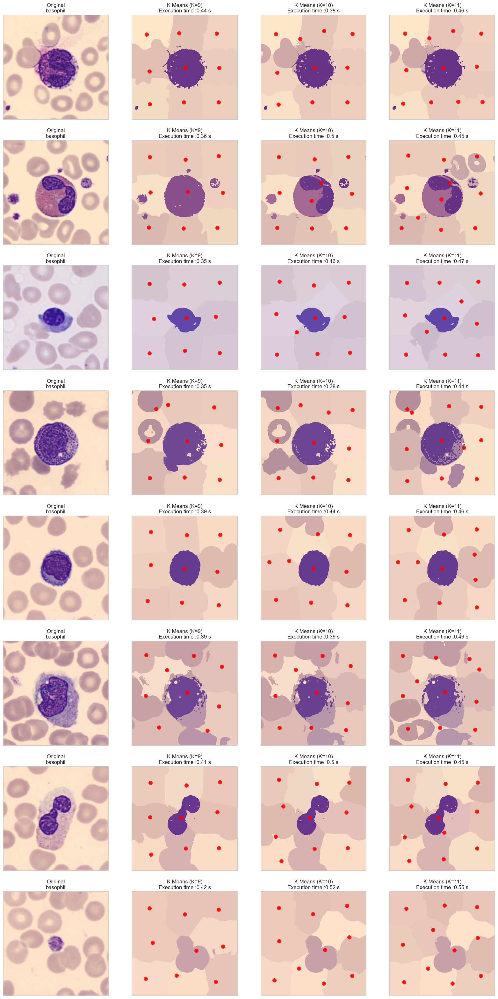

In [36]:
n_Kmeans_clusters = [9,10,11]
npc = 1
Show_KmeansXYRGB_Sample(df_infos,sample_per_cell_type=npc,n_clusters_range = n_Kmeans_clusters, show_centroids = True)
plt.savefig('Analysis/Analysis_KmeansXYRGB_'+str(npc*8)+'cells_'+str(n_Kmeans_clusters).replace(',','x').replace(' ','').replace('[','').replace(']','')+'.jpg')

> On gardera **K=10** qui est le nombre de clusters le plus faible permettant de conserver la nuance de dégradé de couleur à l'intérieur du cytoplasme de la cellule

## 6.2. Segmentation par Mean Shift

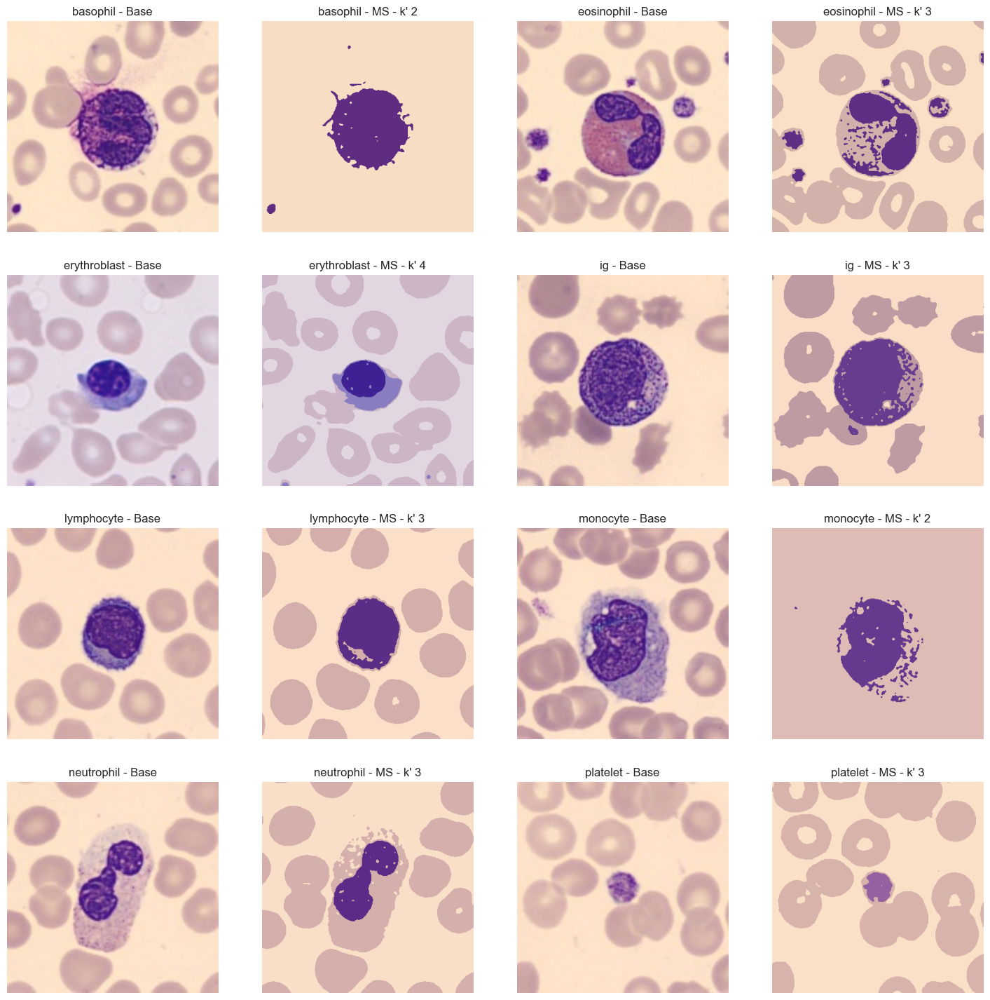

In [41]:
""" Cette fonction qui utilise un MeanShift définit un nombre de clusters sur l'image à l'aide de la
    fonction fournie "estimate_bandwidth". Ces clusters regroupe les pixel sur une plage RGB (centroid).
    La valeur des centroids est ensuite attribué à chaque pixel du cluster associé. 
    L'image reformé est donc constitué de N couleur, correspondant aux nombre de clusters."""

figure = plt.figure(figsize=(18,18)) 
index_tmp = 1
#index_filtered_img= 0
for i, path_image in enumerate(img_random['path_image']):        
    img = cv2.imread(path_image,cv2.IMREAD_COLOR)
    img = cv2.resize(img,(360,360))
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.subplot(4,4,index_tmp)
    plt.title(f"{img_random['category'][i]} - Base")
    plt.axis('off') 
    plt.imshow(img, 'gray');
    index_tmp+=1
    
    # filtre de réduction du bruit
    img = cv2.medianBlur(img, 3)

    # On aplatit l'image
    flat_image = img.reshape(img.shape[0]*img.shape[1], img.shape[2])

    # meanshift
    bandwidth = estimate_bandwidth(flat_image, quantile=0.5, n_samples=100)
    ms = MeanShift(bandwidth=bandwidth, max_iter=2000, bin_seeding=True)
    ms.fit(flat_image)
    labels=ms.labels_                                   # Pour chaque pixel, on récupere le label estimé.
    centroids = ms.cluster_centers_                     # On recupère les centroids ([R G B] moyen pour chaque)

    centroids = np.uint8(centroids)
    result = centroids[labels]
    result = result.reshape(img.shape)

    #Affichage du resultat
    plt.subplot(4,4,index_tmp)
    plt.title(f"{img_random['category'][i]} - MS - k' {str(centroids.shape[0])}")
    plt.axis('off')    
    plt.imshow(result, 'gray');
    index_tmp+=1
    
plt.savefig('Analysis/Analysis_MeanShift.jpg')